In [1]:
# Dependencies and Setup
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import requests
import gmaps
import os
import json
from config import api_key
from config2 import api_key_2

In [2]:
animal_bites_file = pd.read_csv('animalbites.csv')
df = pd.DataFrame(animal_bites_file)



df['Latitude']= ""
df['Longitude']= ""

df

,bite_date,SpeciesIDDesc,BreedIDDesc,GenderIDDesc,color,vaccination_yrs,vaccination_date,victim_zip,AdvIssuedYNDesc,WhereBittenIDDesc,quarantine_date,DispositionIDDesc,head_sent_date,release_date,ResultsIDDesc,Latitude,Longitude
0,1985-05-05 00:00:00,DOG,NaN,FEMALE,LIG. BROWN,1.0,1985-06-20 00:00:00,40229,NO,BODY,1985-05-05 00:00:00,UNKNOWN,NaN,NaN,UNKNOWN,,
1,1986-02-12 00:00:00,DOG,NaN,UNKNOWN,BRO & BLA,NaN,NaN,40218,NO,BODY,1986-02-12 00:00:00,UNKNOWN,NaN,NaN,UNKNOWN,,
2,1987-05-07 00:00:00,DOG,NaN,UNKNOWN,NaN,NaN,NaN,40219,NO,BODY,1990-05-07 00:00:00,UNKNOWN,NaN,NaN,UNKNOWN,,
3,1988-10-02 00:00:00,DOG,NaN,MALE,BLA & BRO,NaN,NaN,NaN,NO,BODY,1990-10-02 00:00:00,UNKNOWN,NaN,NaN,UNKNOWN,,
4,1989-08-29 00:00:00,DOG,NaN,FEMALE,BLK-WHT,NaN,NaN,NaN,NO,BODY,NaN,UNKNOWN,NaN,NaN,UNKNOWN,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8998,2017-09-05 00:00:00,DOG,NaN,NaN,NaN,NaN,NaN,40243,NaN,UNKNOWN,NaN,NaN,NaN,NaN,NaN,,
8999,2017-09-07 00:00:00,DOG,POMERANIAN,MALE,RED,NaN,NaN,40204,NaN,HEAD,NaN,NaN,NaN,NaN,NaN,,
9000,2017-09-07 00:00:00,DOG,LABRADOR RETRIV,MALE,BROWN,NaN,NaN,47130,NaN,UNKNOWN,NaN,NaN,NaN,NaN,NaN,,
9001,2017-09-07 00:00:00,DOG,LABRADOR RETRIV,FEMALE,BLK WHT,NaN,NaN,40229,NaN,BODY,NaN,NaN,NaN,NaN,NaN,,


In [3]:
df["formatted_date"]= pd.to_datetime(df.iloc[:,0], errors="coerce")
df.head()

,bite_date,SpeciesIDDesc,BreedIDDesc,GenderIDDesc,color,vaccination_yrs,vaccination_date,victim_zip,AdvIssuedYNDesc,WhereBittenIDDesc,quarantine_date,DispositionIDDesc,head_sent_date,release_date,ResultsIDDesc,Latitude,Longitude,formatted_date
0,1985-05-05 00:00:00,DOG,NaN,FEMALE,LIG. BROWN,1.0,1985-06-20 00:00:00,40229,NO,BODY,1985-05-05 00:00:00,UNKNOWN,NaN,NaN,UNKNOWN,,,1985-05-05
1,1986-02-12 00:00:00,DOG,NaN,UNKNOWN,BRO & BLA,NaN,NaN,40218,NO,BODY,1986-02-12 00:00:00,UNKNOWN,NaN,NaN,UNKNOWN,,,1986-02-12
2,1987-05-07 00:00:00,DOG,NaN,UNKNOWN,NaN,NaN,NaN,40219,NO,BODY,1990-05-07 00:00:00,UNKNOWN,NaN,NaN,UNKNOWN,,,1987-05-07
3,1988-10-02 00:00:00,DOG,NaN,MALE,BLA & BRO,NaN,NaN,NaN,NO,BODY,1990-10-02 00:00:00,UNKNOWN,NaN,NaN,UNKNOWN,,,1988-10-02
4,1989-08-29 00:00:00,DOG,NaN,FEMALE,BLK-WHT,NaN,NaN,NaN,NO,BODY,NaN,UNKNOWN,NaN,NaN,UNKNOWN,,,1989-08-29


In [4]:
narrowed_df = df[['formatted_date', 'SpeciesIDDesc', 'BreedIDDesc', 'GenderIDDesc', 'victim_zip','Latitude','Longitude', 'WhereBittenIDDesc']]
#narrowed_dpna = narrowed_df.dropna(subset=['victim_zip'])


#narrowed_dpna

In [5]:
data = narrowed_df.rename(columns={"formatted_date": "Date", "SpeciesIDDesc": "Animal Type",
                                  "BreedIDDesc": "Breed", "GenderIDDesc": "Gender",
                                  "victim_zip": "Victim Zip Code", "WhereBittenIDDesc": "Where Bitten"})

data

,Date,Animal Type,Breed,Gender,Victim Zip Code,Latitude,Longitude,Where Bitten
0,1985-05-05,DOG,NaN,FEMALE,40229,,,BODY
1,1986-02-12,DOG,NaN,UNKNOWN,40218,,,BODY
2,1987-05-07,DOG,NaN,UNKNOWN,40219,,,BODY
3,1988-10-02,DOG,NaN,MALE,NaN,,,BODY
4,1989-08-29,DOG,NaN,FEMALE,NaN,,,BODY
...,...,...,...,...,...,...,...,...
8998,2017-09-05,DOG,NaN,NaN,40243,,,UNKNOWN
8999,2017-09-07,DOG,POMERANIAN,MALE,40204,,,HEAD
9000,2017-09-07,DOG,LABRADOR RETRIV,MALE,47130,,,UNKNOWN
9001,2017-09-07,DOG,LABRADOR RETRIV,FEMALE,40229,,,BODY


In [6]:
# removing null values to avoid errors 
#data.dropna(inplace = True)

In [7]:
# start stop and step variables
start, stop, step = 0, -6, 1

# converting to string data type 
data["Date"]= data["Date"].astype(str) 

# slicing till month element 
data["Year"]= data["Date"].str.slice(start, stop, step) 

#data_month_year["Year/Month"]= data["Date"].str.slice(start=0, stop=-3, step=1) 

# display 
data


,Date,Animal Type,Breed,Gender,Victim Zip Code,Latitude,Longitude,Where Bitten,Year
0,1985-05-05,DOG,NaN,FEMALE,40229,,,BODY,1985
1,1986-02-12,DOG,NaN,UNKNOWN,40218,,,BODY,1986
2,1987-05-07,DOG,NaN,UNKNOWN,40219,,,BODY,1987
3,1988-10-02,DOG,NaN,MALE,NaN,,,BODY,1988
4,1989-08-29,DOG,NaN,FEMALE,NaN,,,BODY,1989
...,...,...,...,...,...,...,...,...,...
8998,2017-09-05,DOG,NaN,NaN,40243,,,UNKNOWN,2017
8999,2017-09-07,DOG,POMERANIAN,MALE,40204,,,HEAD,2017
9000,2017-09-07,DOG,LABRADOR RETRIV,MALE,47130,,,UNKNOWN,2017
9001,2017-09-07,DOG,LABRADOR RETRIV,FEMALE,40229,,,BODY,2017


In [8]:
data = data.drop(columns='Date')
data

,Animal Type,Breed,Gender,Victim Zip Code,Latitude,Longitude,Where Bitten,Year
0,DOG,NaN,FEMALE,40229,,,BODY,1985
1,DOG,NaN,UNKNOWN,40218,,,BODY,1986
2,DOG,NaN,UNKNOWN,40219,,,BODY,1987
3,DOG,NaN,MALE,NaN,,,BODY,1988
4,DOG,NaN,FEMALE,NaN,,,BODY,1989
...,...,...,...,...,...,...,...,...
8998,DOG,NaN,NaN,40243,,,UNKNOWN,2017
8999,DOG,POMERANIAN,MALE,40204,,,HEAD,2017
9000,DOG,LABRADOR RETRIV,MALE,47130,,,UNKNOWN,2017
9001,DOG,LABRADOR RETRIV,FEMALE,40229,,,BODY,2017


In [9]:
data = data.sort_values('Gender')
data

,Animal Type,Breed,Gender,Victim Zip Code,Latitude,Longitude,Where Bitten,Year
0,DOG,NaN,FEMALE,40229,,,BODY,1985
4672,DOG,NaN,FEMALE,40245,,,BODY,2013
4674,DOG,LABRADOR RETRIV,FEMALE,40291,,,BODY,2013
4675,DOG,PIT BULL,FEMALE,40203,,,BODY,2013
4680,DOG,PIT BULL,FEMALE,40212,,,NaN,
...,...,...,...,...,...,...,...,...
8984,CAT,NaN,NaN,40291,,,UNKNOWN,2017
8992,DOG,PIT BULL,NaN,40207,,,BODY,2017
8996,DOG,NaN,NaN,40214,,,BODY,2017
8998,DOG,NaN,NaN,40243,,,UNKNOWN,2017


In [10]:
#add columns for lat and lon
# data['Latitude'] = ""
# data['Longitude'] = ""

In [11]:
animals_types =data['Animal Type'].value_counts()
animals_types

DOG        7029
CAT        1568
BAT         237
RACCOON      27
OTHER        11
HORSE         5
FERRET        4
RABBIT        3
SKUNK         1
Name: Animal Type, dtype: int64

In [12]:
animals_gen=data['Gender'].value_counts()
animals_gen

MALE       3832
FEMALE     2016
UNKNOWN     629
Name: Gender, dtype: int64

In [13]:
animals_desc=data['Breed'].value_counts()
animals_desc

PIT BULL           1102
GERM SHEPHERD       327
LABRADOR RETRIV     253
BOXER               181
CHICHAUHUA          165
                   ... 
BESINJI               1
BEARDED COLLIE        1
WEINER DOG            1
FOX TERRIER MIX       1
STAN POODLE           1
Name: Breed, Length: 101, dtype: int64

In [14]:
bite_desc=data['Where Bitten'].value_counts()
bite_desc

BODY       6213
HEAD       1244
UNKNOWN     930
Name: Where Bitten, dtype: int64

In [15]:
data_year_filtered = data[(data['Year'] >= "2013") & (data['Year'] <= "2017")]

data_year_filtered

,Animal Type,Breed,Gender,Victim Zip Code,Latitude,Longitude,Where Bitten,Year
4672,DOG,NaN,FEMALE,40245,,,BODY,2013
4674,DOG,LABRADOR RETRIV,FEMALE,40291,,,BODY,2013
4675,DOG,PIT BULL,FEMALE,40203,,,BODY,2013
4688,CAT,NaN,FEMALE,40203,,,BODY,2013
4690,CAT,NaN,FEMALE,NaN,,,BODY,2013
...,...,...,...,...,...,...,...,...
8984,CAT,NaN,NaN,40291,,,UNKNOWN,2017
8992,DOG,PIT BULL,NaN,40207,,,BODY,2017
8996,DOG,NaN,NaN,40214,,,BODY,2017
8998,DOG,NaN,NaN,40243,,,UNKNOWN,2017


In [16]:
data_year_filtered_droppedNA = data_year_filtered.dropna(subset=['Victim Zip Code'])

data_year_filtered_droppedNA

,Animal Type,Breed,Gender,Victim Zip Code,Latitude,Longitude,Where Bitten,Year
4672,DOG,NaN,FEMALE,40245,,,BODY,2013
4674,DOG,LABRADOR RETRIV,FEMALE,40291,,,BODY,2013
4675,DOG,PIT BULL,FEMALE,40203,,,BODY,2013
4688,CAT,NaN,FEMALE,40203,,,BODY,2013
4692,DOG,NaN,FEMALE,40241,,,BODY,2013
...,...,...,...,...,...,...,...,...
8984,CAT,NaN,NaN,40291,,,UNKNOWN,2017
8992,DOG,PIT BULL,NaN,40207,,,BODY,2017
8996,DOG,NaN,NaN,40214,,,BODY,2017
8998,DOG,NaN,NaN,40243,,,UNKNOWN,2017


In [17]:

    
    
#     print(json.dumps(zip_data, indent=4, sort_keys=True))


# zipcode = "40229"



#geo_data = requests.get(target_url).json()





In [18]:
data_year_filtered

,Animal Type,Breed,Gender,Victim Zip Code,Latitude,Longitude,Where Bitten,Year
4672,DOG,NaN,FEMALE,40245,,,BODY,2013
4674,DOG,LABRADOR RETRIV,FEMALE,40291,,,BODY,2013
4675,DOG,PIT BULL,FEMALE,40203,,,BODY,2013
4688,CAT,NaN,FEMALE,40203,,,BODY,2013
4690,CAT,NaN,FEMALE,NaN,,,BODY,2013
...,...,...,...,...,...,...,...,...
8984,CAT,NaN,NaN,40291,,,UNKNOWN,2017
8992,DOG,PIT BULL,NaN,40207,,,BODY,2017
8996,DOG,NaN,NaN,40214,,,BODY,2017
8998,DOG,NaN,NaN,40243,,,UNKNOWN,2017


In [19]:
#make a chart to show bites by year

data_by_year = pd.DataFrame(data_year_filtered.groupby('Year').agg({'Animal Type': ['count']}))

data_by_year

,Animal Type
,count
Year,
2013,1133
2014,1155
2015,978
2016,1049
2017,793


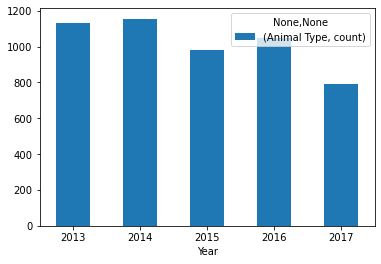

In [20]:
Year_Bar_Plt = data_by_year.plot.bar(rot=0)

In [21]:
#dissect 2014

data_year_filtered.loc[(data_year_filtered['Year'] == "2014")]

data_year_filtered

,Animal Type,Breed,Gender,Victim Zip Code,Latitude,Longitude,Where Bitten,Year
4672,DOG,NaN,FEMALE,40245,,,BODY,2013
4674,DOG,LABRADOR RETRIV,FEMALE,40291,,,BODY,2013
4675,DOG,PIT BULL,FEMALE,40203,,,BODY,2013
4688,CAT,NaN,FEMALE,40203,,,BODY,2013
4690,CAT,NaN,FEMALE,NaN,,,BODY,2013
...,...,...,...,...,...,...,...,...
8984,CAT,NaN,NaN,40291,,,UNKNOWN,2017
8992,DOG,PIT BULL,NaN,40207,,,BODY,2017
8996,DOG,NaN,NaN,40214,,,BODY,2017
8998,DOG,NaN,NaN,40243,,,UNKNOWN,2017


In [22]:
#dissecting 2014 pt.2

data_by_zipcode_2014 = pd.DataFrame(data_year_filtered_2014.groupby('Victim Zip Code').agg({'Year': ['count']}).reset_index())


Zipcode_Bar_Plt = data_by_zipcode_2014.plot.bar(rot=0)

NameError: name 'data_year_filtered_2014' is not defined

In [105]:
url = 'https://maps.googleapis.com/maps/api/geocode/json?'

#test_zip = "77477"

for index, row in data.iterrows():
    
    zipcodes = row['Victim Zip Code']
    
    query_url = f'{url}components=postal_code:{zipcodes}&key={api_key}'
    
    zip_response = requests.get(query_url)
    zip_data = zip_response.json()
    
    
    try:
        data.loc[index, 'Latitude'] = zip_data["results"][0]["geometry"]["location"]["lat"]
        data.loc[index, 'Longitude'] = zip_data["results"][0]["geometry"]["location"]["lng"]
        
    except IndexError:
        pass
    

    
    print(json.dumps(zip_data, indent=4, sort_keys=True))

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
           

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
   

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "typ

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47454",
                    "short_name": "47454",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Paoli",
                    "short_name": "Paoli",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Orange County",
                    "short_name": "Orange County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40202",
                    "short_name": "40202",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "65809",
                    "short_name": "65809",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Springfield",
                    "short_name": "Springfield",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Greene County",
                    "short_name": "Greene County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Missouri",
                    "short_name": "MO",
                    "types": [
                        "administrative_area_le

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
      

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40109",
                    "short_name": "40109",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Brooks",
                    "short_name": "Brooks",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Bullitt County",
                    "short_name": "Bullitt County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",


{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
            

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
    

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47250",
                    "short_name": "47250",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Brooksburg",
                    "short_name": "Brooksburg",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "p

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47161",
                    "short_name": "47161",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Salisbury",
                    "short_name": "New Salisbury",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Harrison County",
                    "short_name": "Harrison County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40071",
                    "short_name": "40071",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Taylorsville",
                    "short_name": "Taylorsville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administ

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                 

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47165",
                    "short_name": "47165",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Pekin",
                    "short_name": "New Pekin",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_na

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
      

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
    

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
             

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                  

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
    

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47106",
                    "short_name": "47106",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Borden",
                    "short_name": "Borden",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "political

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47150",
                    "short_name": "47150",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Albany",
                    "short_name": "New Albany",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "p

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40056",
                    "short_name": "40056",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Pewee Valley",
                    "short_name": "Pewee Valley",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47112",
                    "short_name": "47112",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Corydon",
                    "short_name": "Corydon",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Harrison County",
                    "short_name": "Harrison County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "42712",
                    "short_name": "42712",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Big Clifty",
                    "short_name": "Big Clifty",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40202",
                    "short_name": "40202",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40014",
                    "short_name": "40014",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "ORCHARD GRASS",
                    "short_name": "ORCHARD GRASS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Oldham County",
                    "short_name": "Oldham County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47130",
                    "short_name": "47130",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Watson",
                    "short_name": "Watson",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "34949",
                    "short_name": "34949",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hutchinson Island",
                    "short_name": "Hutchinson Island",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "St. Lucie County",
                    "short_name": "St Lucie County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Florida",
                    "short_name": "FL",
                    "types": [
                        "ad

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
             

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40031",
                    "short_name": "40031",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "La Grange",
                    "short_name": "La Grange",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "po

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40065",
                    "short_name": "40065",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Shelbyville",
                    "short_name": "Shelbyville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Shelby County",
                    "short_name": "Shelby County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_le

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40047",
                    "short_name": "40047",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Mount Washington",
                    "short_name": "Mt Washington",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_leve

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "29717",
                    "short_name": "29717",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hickory Grove",
                    "short_name": "Hickory Grove",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "York County",
                    "short_name": "York County",
                    "types": [
                        "administrative_area_level_2"

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47166",
                    "short_name": "47166",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Ramsey",
                    "short_name": "Ramsey",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Harrison County",
                    "short_name": "Harrison County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40011",
                    "short_name": "40011",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Campbellsburg",
                    "short_name": "Campbellsburg",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47111",
                    "short_name": "47111",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Charlestown",
                    "short_name": "Charlestown",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "53704",
                    "short_name": "53704",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Madison",
                    "short_name": "Madison",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Dane County",
                    "short_name": "Dane County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Wisconsin",
                    "short_name": "WI",
                    "types": [
                        "administrative_area_level_1",
   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40067",
                    "short_name": "40067",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Simpsonville",
                    "short_name": "Simpsonville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40150",
                    "short_name": "40150",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "LEBANON JCTN",
                    "short_name": "LEBANON JCTN",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
    

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
             

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40202",
                    "short_name": "40202",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40165",
                    "short_name": "40165",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HUNTERS HLW",
                    "short_name": "HUNTERS HLW",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Bullitt County",
                    "short_name": "Bullitt County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40150",
                    "short_name": "40150",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "LEBANON JCTN",
                    "short_name": "LEBANON JCTN",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40108",
                    "short_name": "40108",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Brandenburg",
                    "short_name": "Brandenburg",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Meade County",
                    "short_name": "Meade County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_leve

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40071",
                    "short_name": "40071",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Taylorsville",
                    "short_name": "Taylorsville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "29455",
                    "short_name": "29455",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Seabrook Island",
                    "short_name": "Seabrook Island",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Charleston County",
                    "short_name": "Charleston County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "South Carolina",
                    "short_name": "SC",
                    "types": [
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40165",
                    "short_name": "40165",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HUNTERS HLW",
                    "short_name": "HUNTERS HLW",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Bullitt County",
                    "short_name": "Bullitt County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "42784",
                    "short_name": "42784",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Upton",
                    "short_name": "Upton",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "political"

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40031",
                    "short_name": "40031",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "La Grange",
                    "short_name": "La Grange",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "po

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "32162",
                    "short_name": "32162",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "The Villages",
                    "short_name": "The Villages",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Florida",
                    "short_name": "FL",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                      

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40202",
                    "short_name": "40202",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "99037",
                    "short_name": "99037",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Veradale",
                    "short_name": "Veradale",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Spokane County",
                    "short_name": "Spokane County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Washington",
                    "short_name": "WA",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40261",
                    "short_name": "40261",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40202",
                    "short_name": "40202",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47150",
                    "short_name": "47150",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Albany",
                    "short_name": "New Albany",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "p

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40202",
                    "short_name": "40202",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40162",
                    "short_name": "40162",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Rineyville",
                    "short_name": "Rineyville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Hardin County",
                    "short_name": "Hardin County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_leve

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40065",
                    "short_name": "40065",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Shelbyville",
                    "short_name": "Shelbyville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Shelby County",
                    "short_name": "Shelby County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_le

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40108",
                    "short_name": "40108",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Brandenburg",
                    "short_name": "Brandenburg",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Meade County",
                    "short_name": "Meade County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_leve

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40069",
                    "short_name": "40069",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Springfield",
                    "short_name": "Springfield",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
 

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "typ

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40505",
                    "short_name": "40505",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Lexington",
                    "short_name": "Lexington",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Fayette County",
                    "short_name": "Fayette County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_leve

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "37204",
                    "short_name": "37204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Melrose",
                    "short_name": "Melrose",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Davidson County",
                    "short_name": "Davidson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Tennessee",
                    "short_name": "TN",
                    "types": [
                        "administrative_area_l

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40047",
                    "short_name": "40047",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Mount Washington",
                    "short_name": "Mt Washington",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47150",
                    "short_name": "47150",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Albany",
                    "short_name": "New Albany",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "p

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40201",
                    "short_name": "40201",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Old Louisville",
                    "short_name": "Old Louisville",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
              

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "20016",
                    "short_name": "20016",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Washington",
                    "short_name": "Washington",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "District of Columbia",
                    "short_name": "DC",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
             

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "43228",
                    "short_name": "43228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Columbus",
                    "short_name": "Columbus",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Franklin County",
                    "short_name": "Franklin County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Ohio",
                    "short_name": "OH",
                    "types": [
                        "administrative_area_level_1"

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
  

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47114",
                    "short_name": "47114",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Crandall",
                    "short_name": "Crandall",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jackson Township",
                    "short_name": "Jackson Township",
                    "types": [
                        "administrative_area_level_3",
                        "political"
                    ]
                },
                {
                    "long_name": "Harrison County",
                    "short_name": "Harrison County",
                    "types": [
                        "ad

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47130",
                    "short_name": "47130",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Watson",
                    "short_name": "Watson",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
            

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
              

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "15237",
                    "short_name": "15237",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "McKnight",
                    "short_name": "McKnight",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Allegheny County",
                    "short_name": "Allegheny County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Pennsylvania",
      

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47150",
                    "short_name": "47150",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Albany",
                    "short_name": "New Albany",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "p

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40165",
                    "short_name": "40165",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HUNTERS HLW",
                    "short_name": "HUNTERS HLW",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Bullitt County",
                    "short_name": "Bullitt County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47130",
                    "short_name": "47130",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Watson",
                    "short_name": "Watson",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47129",
                    "short_name": "47129",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Clarksville",
                    "short_name": "Clarksville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "typ

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40004",
                    "short_name": "40004",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Bardstown",
                    "short_name": "Bardstown",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Nelson County",
                    "short_name": "Nelson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40014",
                    "short_name": "40014",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "ORCHARD GRASS",
                    "short_name": "ORCHARD GRASS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Oldham County",
                    "short_name": "Oldham County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "42726",
                    "short_name": "42726",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Wax",
                    "short_name": "Wax",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Grayson County",
                    "short_name": "Grayson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
      

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "typ

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47126",
                    "short_name": "47126",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Henryville",
                    "short_name": "Henryville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "p

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40108",
                    "short_name": "40108",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Brandenburg",
                    "short_name": "Brandenburg",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Meade County",
                    "short_name": "Meade County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_leve

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40165",
                    "short_name": "40165",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HUNTERS HLW",
                    "short_name": "HUNTERS HLW",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Bullitt County",
                    "short_name": "Bullitt County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40178",
                    "short_name": "40178",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Westview",
                    "short_name": "Westview",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Breckinridge County",
                    "short_name": "Breckinridge County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40071",
                    "short_name": "40071",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Taylorsville",
                    "short_name": "Taylorsville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40165",
                    "short_name": "40165",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HUNTERS HLW",
                    "short_name": "HUNTERS HLW",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Bullitt County",
                    "short_name": "Bullitt County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
      

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "41091",
                    "short_name": "41091",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Union",
                    "short_name": "Union",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Boone County",
                    "short_name": "Boone County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
      

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47119",
                    "short_name": "47119",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Galena",
                    "short_name": "Galena",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "political

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40047",
                    "short_name": "40047",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Mount Washington",
                    "short_name": "Mt Washington",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40047",
                    "short_name": "40047",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Mount Washington",
                    "short_name": "Mt Washington",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40014",
                    "short_name": "40014",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "ORCHARD GRASS",
                    "short_name": "ORCHARD GRASS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Oldham County",
                    "short_name": "Oldham County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40047",
                    "short_name": "40047",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Mount Washington",
                    "short_name": "Mt Washington",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40202",
                    "short_name": "40202",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
 

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
              

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47172",
                    "short_name": "47172",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Sellersburg",
                    "short_name": "Sellersburg",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47130",
                    "short_name": "47130",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Watson",
                    "short_name": "Watson",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40004",
                    "short_name": "40004",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Bardstown",
                    "short_name": "Bardstown",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Nelson County",
                    "short_name": "Nelson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40162",
                    "short_name": "40162",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Rineyville",
                    "short_name": "Rineyville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Hardin County",
                    "short_name": "Hardin County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_leve

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
              

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40504",
                    "short_name": "40504",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Lexington",
                    "short_name": "Lexington",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Fayette County",
                    "short_name": "Fayette County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types":

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
        

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
  

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "typ

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
    

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
      

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40071",
                    "short_name": "40071",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Taylorsville",
                    "short_name": "Taylorsville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "30067",
                    "short_name": "30067",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Marietta",
                    "short_name": "Marietta",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Cobb County",
                    "short_name": "Cobb County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Georgia",
                    "short_name": "GA",
                    "types": [
      

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47150",
                    "short_name": "47150",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Albany",
                    "short_name": "New Albany",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "p

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
    

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
        

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "60622",
                    "short_name": "60622",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Chicago",
                    "short_name": "Chicago",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Cook County",
                    "short_name": "Cook County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Illinois",
                    "short_name": "IL",
                    "types": [
                        "administrative_area_level_1",
    

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
             

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
            

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "98105",
                    "short_name": "98105",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Seattle",
                    "short_name": "Seattle",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "King County",
                    "short_name": "King County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Washington",
                    "short_name": "WA",
                    "types": [
                        "administrative_area_level_1",
  

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                  

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                 

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "42754",
                    "short_name": "42754",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Leitchfield",
                    "short_name": "Leitchfield",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "42141",
                    "short_name": "42141",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Glasgow",
                    "short_name": "Glasgow",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Barren County",
                    "short_name": "Barren County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",


{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
    

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40160",
                    "short_name": "40160",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Radcliff",
                    "short_name": "Radcliff",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Hardin County",
                    "short_name": "Hardin County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1"

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
      

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                  

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47119",
                    "short_name": "47119",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Galena",
                    "short_name": "Galena",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                 

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
  

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_leve

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40014",
                    "short_name": "40014",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "ORCHARD GRASS",
                    "short_name": "ORCHARD GRASS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Oldham County",
                    "short_name": "Oldham County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                  

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
             

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
      

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40031",
                    "short_name": "40031",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "La Grange",
                    "short_name": "La Grange",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_na

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "42718",
                    "short_name": "42718",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "CAMPBELLSVLLE",
                    "short_name": "CAMPBELLSVLLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
    

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
   

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40071",
                    "short_name": "40071",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Taylorsville",
                    "short_name": "Taylorsville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
    

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
             

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
              

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "typ

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
    

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40065",
                    "short_name": "40065",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Shelbyville",
                    "short_name": "Shelbyville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Shelby County",
                    "short_name": "Shelby County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_le

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47165",
                    "short_name": "47165",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Pekin",
                    "short_name": "New Pekin",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "pol

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40109",
                    "short_name": "40109",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Brooks",
                    "short_name": "Brooks",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Bullitt County",
                    "short_name": "Bullitt County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",


{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "22989",
                    "short_name": "22989",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WOODBERRY FOR",
                    "short_name": "WOODBERRY FOR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Locust Dale",
                    "short_name": "Locust Dale",
                    "types": [
                        "administrative_area_level_3",
                        "political"
                    ]
                },
                {
                    "long_name": "Madison County",
                    "short_name": "Madison County",
                    "types": [
                        "admi

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "42765",
                    "short_name": "42765",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Munfordville",
                    "short_name": "Munfordville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Hart County",
                    "short_name": "Hart County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_leve

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40023",
                    "short_name": "40023",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Fisherville",
                    "short_name": "Fisherville",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40165",
                    "short_name": "40165",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HUNTERS HLW",
                    "short_name": "HUNTERS HLW",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Bullitt County",
                    "short_name": "Bullitt County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "typ

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
  

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40165",
                    "short_name": "40165",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HUNTERS HLW",
                    "short_name": "HUNTERS HLW",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Bullitt County",
                    "short_name": "Bullitt County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47150",
                    "short_name": "47150",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Albany",
                    "short_name": "New Albany",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "p

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
        

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "typ

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "typ

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
    

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40071",
                    "short_name": "40071",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Taylorsville",
                    "short_name": "Taylorsville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                     

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
             

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "45140",
                    "short_name": "45140",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Montgomery",
                    "short_name": "Montgomery",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Ohio",
                    "short_name": "OH",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
            

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
             

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47150",
                    "short_name": "47150",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Albany",
                    "short_name": "New Albany",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "p

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40004",
                    "short_name": "40004",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Bardstown",
                    "short_name": "Bardstown",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Nelson County",
                    "short_name": "Nelson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40031",
                    "short_name": "40031",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "La Grange",
                    "short_name": "La Grange",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "po

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "42157",
                    "short_name": "42157",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Mount Hermon",
                    "short_name": "Mt Hermon",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Monroe County",
                    "short_name": "Monroe County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_lev

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "48162",
                    "short_name": "48162",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Monroe",
                    "short_name": "Monroe",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Monroe County",
                    "short_name": "Monroe County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Michigan",
                    "short_name": "MI",
                    "types": [
                        "administrative_area_level_1",
  

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40004",
                    "short_name": "40004",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Bardstown",
                    "short_name": "Bardstown",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Nelson County",
                    "short_name": "Nelson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47130",
                    "short_name": "47130",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Watson",
                    "short_name": "Watson",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40202",
                    "short_name": "40202",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "77701",
                    "short_name": "77701",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Beaumont",
                    "short_name": "Beaumont",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Texas",
                    "short_name": "TX",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "politic

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
      

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40047",
                    "short_name": "40047",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Mount Washington",
                    "short_name": "Mt Washington",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40202",
                    "short_name": "40202",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
              

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40025",
                    "short_name": "40025",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Glenview",
                    "short_name": "Glenview",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_le

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40014",
                    "short_name": "40014",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "ORCHARD GRASS",
                    "short_name": "ORCHARD GRASS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Oldham County",
                    "short_name": "Oldham County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47130",
                    "short_name": "47130",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Watson",
                    "short_name": "Watson",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40165",
                    "short_name": "40165",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HUNTERS HLW",
                    "short_name": "HUNTERS HLW",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Bullitt County",
                    "short_name": "Bullitt County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47129",
                    "short_name": "47129",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Clarksville",
                    "short_name": "Clarksville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47630",
                    "short_name": "47630",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Newburgh",
                    "short_name": "Newburgh",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Warrick County",
                    "short_name": "Warrick County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47130",
                    "short_name": "47130",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Watson",
                    "short_name": "Watson",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
   

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47150",
                    "short_name": "47150",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Albany",
                    "short_name": "New Albany",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "p

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
  

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47150",
                    "short_name": "47150",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Albany",
                    "short_name": "New Albany",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_n

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "27050",
                    "short_name": "27050",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Tobaccoville",
                    "short_name": "Tobaccoville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "North Carolina",
                    "short_name": "NC",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                 

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name"

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_nam

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "42743",
                    "short_name": "42743",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Greensburg",
                    "short_name": "Greensburg",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "50216",
                    "short_name": "50216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Panora",
                    "short_name": "Panora",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Guthrie County",
                    "short_name": "Guthrie County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]


{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
  

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47130",
                    "short_name": "47130",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Watson",
                    "short_name": "Watson",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
             

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
            

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types":

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40031",
                    "short_name": "40031",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "La Grange",
                    "short_name": "La Grange",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_na

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47130",
                    "short_name": "47130",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Watson",
                    "short_name": "Watson",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
        

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40202",
                    "short_name": "40202",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
   

}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_n

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name"

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
        

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
 

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
  

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47130",
                    "short_name": "47130",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Watson",
                    "short_name": "Watson",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
     

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40071",
                    "short_name": "40071",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Taylorsville",
                    "short_name": "Taylorsville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
    

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "92037",
                    "short_name": "92037",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "La Jolla",
                    "short_name": "La Jolla",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "San Diego County",
                    "short_name": "San Diego County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "California",
        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40047",
                    "short_name": "40047",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Mount Washington",
                    "short_name": "Mt Washington",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47150",
                    "short_name": "47150",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "New Albany",
                    "short_name": "New Albany",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
           

}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
          

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_a

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
          

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40065",
                    "short_name": "40065",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Shelbyville",
                    "short_name": "Shelbyville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Shelby County",
                    "short_name": "Shelby County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_le

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name"

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47130",
                    "short_name": "47130",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Watson",
                    "short_name": "Watson",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
     

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
        

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "36542",
                    "short_name": "36542",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Gulf Shores",
                    "short_name": "Gulf Shores",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Baldwin County",
                    "short_name": "Baldwin County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Alabama",
             

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "45014",
                    "short_name": "45014",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hamilton",
                    "short_name": "Hamilton",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Butler County",
                    "short_name": "Butler County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Ohio",
                    "short_name": "OH",
                    "types": [
                        "administrative_area_level_1",
  

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40160",
                    "short_name": "40160",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Radcliff",
                    "short_name": "Radcliff",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Hardin County",
                    "short_name": "Hardin County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1"

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40014",
                    "short_name": "40014",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "ORCHARD GRASS",
                    "short_name": "ORCHARD GRASS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Oldham County",
                    "short_name": "Oldham County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40511",
                    "short_name": "40511",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Lexington",
                    "short_name": "Lexington",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "po

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "t

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40219",
                    "short_name": "40219",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Heritage Creek",
                    "short_name": "Heritage Creek",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administra

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40272",
                    "short_name": "40272",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [],
    "status": "ZERO_RESULTS"
}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40202",
                    "short_name": "40202",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40213",
                    "short_name": "40213",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40214",
                    "short_name": "40214",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40241",
                    "short_name": "40241",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "HILLS DALES",
                    "short_name": "HILLS DALES",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                       

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40258",
                    "short_name": "40258",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "PLEASURE RDGE",
                    "short_name": "PLEASURE RDGE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40204",
                    "short_name": "40204",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

}
{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40118",
                    "short_name": "40118",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Hollyvilla",
                    "short_name": "Hollyvilla",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40215",
                    "short_name": "40215",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40059",
                    "short_name": "40059",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Prospect",
                    "short_name": "Prospect",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "poli

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40206",
                    "short_name": "40206",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40228",
                    "short_name": "40228",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Spring Mill",
                    "short_name": "Spring Mill",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_a

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40220",
                    "short_name": "40220",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Saint Regis Park",
                    "short_name": "St Regis Park",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administr

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40210",
                    "short_name": "40210",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40205",
                    "short_name": "40205",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "STRATHMR MNR",
                    "short_name": "STRATHMR MNR",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40243",
                    "short_name": "40243",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40202",
                    "short_name": "40202",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47172",
                    "short_name": "47172",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Sellersburg",
                    "short_name": "Sellersburg",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40218",
                    "short_name": "40218",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Buechel",
                    "short_name": "Buechel",
                    "types": [
                        "neighborhood",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40223",
                    "short_name": "40223",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "MEADOWBRK FRM",
                    "short_name": "MEADOWBRK FRM",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40222",
                    "short_name": "40222",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "GRYMR-DEVNDLE",
                    "short_name": "GRYMR-DEVNDLE",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40212",
                    "short_name": "40212",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40229",
                    "short_name": "40229",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                        "

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40203",
                    "short_name": "40203",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40216",
                    "short_name": "40216",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40245",
                    "short_name": "40245",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "WORTHNGTN HLS",
                    "short_name": "WORTHNGTN HLS",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_area_level_1",
                        "political"
                    ]
                },
                {
                    "long_name": "United States",
                    "short_name": "US",
                    "types": [
                        "country",
                   

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "47130",
                    "short_name": "47130",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Watson",
                    "short_name": "Watson",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Clark County",
                    "short_name": "Clark County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Indiana",
                    "short_name": "IN",
                    "types": [
                        "administrative_area_level_1",
     

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40208",
                    "short_name": "40208",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40217",
                    "short_name": "40217",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40299",
                    "short_name": "40299",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40242",
                    "short_name": "40242",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "OLD BROWNSBRO",
                    "short_name": "OLD BROWNSBRO",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40211",
                    "short_name": "40211",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40291",
                    "short_name": "40291",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "Louisville",
                    "short_name": "Louisville",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrative_are

{
    "results": [
        {
            "address_components": [
                {
                    "long_name": "40207",
                    "short_name": "40207",
                    "types": [
                        "postal_code"
                    ]
                },
                {
                    "long_name": "BRWNSBORO VLG",
                    "short_name": "BRWNSBORO VLG",
                    "types": [
                        "locality",
                        "political"
                    ]
                },
                {
                    "long_name": "Jefferson County",
                    "short_name": "Jefferson County",
                    "types": [
                        "administrative_area_level_2",
                        "political"
                    ]
                },
                {
                    "long_name": "Kentucky",
                    "short_name": "KY",
                    "types": [
                        "administrati

In [29]:
data_year_2014 = data.loc[(data['Year'] == "2014")]

#data_year_2014['Latitude'] = data_year_2014['Latitude'].astype(float)

data_year_2014

#data_year_filtered_2014_gm.to_csv('check_lat.csv')


#data_year_filtered_2014_gm[:-1].reset_index()




,Animal Type,Breed,Gender,Victim Zip Code,Latitude,Longitude,Where Bitten,Year
5390,DOG,CHICHAUHUA,FEMALE,NaN,,,BODY,2014
5402,DOG,NaN,FEMALE,40203,,,BODY,2014
5412,DOG,NaN,FEMALE,65809,,,BODY,2014
5417,DOG,SHIH TZU,FEMALE,40222,,,BODY,2014
5418,CAT,NaN,FEMALE,NaN,,,BODY,2014
...,...,...,...,...,...,...,...,...
6176,DOG,BLACK LAB,NaN,NaN,,,BODY,2014
6177,DOG,NaN,NaN,NaN,,,BODY,2014
6179,DOG,NaN,NaN,NaN,,,BODY,2014
6190,DOG,LABRADOR RETRIV,NaN,NaN,,,BODY,2014


In [30]:
grouped_data = data_year_2014.groupby('Victim Zip Code').agg({'Year': 'count'})


merged_data = pd.merge(grouped_data, lat_lng_clm , on='Victim Zip Code', how='outer')

merged_data.dropna(subset=['Victim Zip Code'])



#grouped_data

NameError: name 'lat_lng_clm' is not defined

In [179]:
merged_data.dtypes

Victim Zip Code     object
Year               float64
Latitude            object
Longitude           object
dtype: object

In [171]:
#merged_data.to_csv('2014_bite_zip.csv')


In [27]:
zip_path = '2014_bite_zip.csv'
zip_read = pd.read_csv(zip_path)

zip_read_drop = zip_read.dropna(subset=['Latitude'])



In [31]:
zip_read_drop

,Unnamed: 0,Victim Zip Code,Year,Latitude,Longitude
0,0,15237.0,1.0,40.561074,-80.039412
1,1,28654.0,1.0,36.055387,-81.152698
2,2,29717.0,1.0,34.979408,-81.449872
3,3,36092.0,1.0,32.638112,-86.195517
4,4,36542.0,1.0,30.299979,-87.677838
...,...,...,...,...,...
520,520,65809.0,1.0,37.179556,-93.188008
521,521,70811.0,1.0,30.534583,-91.125708
522,522,79904.0,1.0,31.868095,-106.475926
523,523,84103.0,1.0,40.810506,-111.844935


In [45]:
most_bites = zip_read_drop.sort_values('Year', ascending= False)

most_bites['Victim Zip Code'].unique()

array([40216., 40215., 40272., 40291., 40229., 40214., 40299., 40219.,
       40245., 40212., 40205., 40211., 40213., 40206., 40258., 40207.,
       40222., 40208., 40241., 40218., 40203., 40204., 40210., 40223.,
       40220., 40217., 40228., 47130., 40242., 40118., 40059., 47150.,
       40031., 40047., 47129., 40202., 40023., 40014., 47111., 40065.,
       40069., 40004., 48872., 47161., 65809., 70811., 46733., 79904.,
       84103., 47122., 47112., 52349., 15237., 46107., 42718., 29717.,
       36092., 36542., 37204., 37228., 37601., 38585., 40026., 40057.,
       40071., 40076., 40109., 40146., 40160., 40165., 40201., 28654.,
       40243., 40505., 41008., 42064., 42086., 42701., 92037.])

In [46]:
most_bites

,Unnamed: 0,Victim Zip Code,Year,Latitude,Longitude
262,262,40216.0,28.0,38.190323,-85.838386
249,249,40216.0,28.0,38.190323,-85.838386
237,237,40216.0,28.0,38.190323,-85.838386
238,238,40216.0,28.0,38.190323,-85.838386
239,239,40216.0,28.0,38.190323,-85.838386
...,...,...,...,...,...
492,492,41008.0,1.0,38.658242,-85.168674
493,493,42064.0,1.0,37.325246,-88.129139
494,494,42086.0,1.0,37.098046,-88.768638
495,495,42701.0,1.0,37.703005,-85.864720


In [74]:
#gmaps
gmaps.configure(api_key=api_key)

#kentucky_coord = (38.2527, 85.7585)

zipcod = zip_read_drop[['Latitude','Longitude']]

counts = zip_read_drop['Year']

fig = gmaps.figure()

heat_layer = gmaps.heatmap_layer(zipcod, weights=counts)

heat_layer.point_radius = 25
#heat_layer.gradient = ['green', 'white']


fig.add_layer(heat_layer)

fig

Figure(layout=FigureLayout(height='420px'))

In [75]:
# Using the template add the hotel marks to the heatmap
info_box_template = """
<dl>
<dt>Name</dt><dd>{Victim Zip Code}</dd>
<dt>City</dt><dd>{Year}</dd>
</dl>
"""
# Store the DataFrame Row
# NOTE: be sure to update with your DataFrame name
# crime_info = [info_box_template.format(**row) for index, row in zip_read_drop.iterrows()]
location = [(38.190323, -85.838386),(38.1830462, -85.7820416),(38.0950217, -85.8281458),(38.1173104, -85.5715015),(38.099271, -85.6537627)]

In [77]:
mark_layer = gmaps.marker_layer(location, info_box_content = ['Zip Code: 40216', 'Zip Code: 40215','Zip Code: 40272', 'Zip Code: 40291', 'Zip Code: 40229'])

fig.add_layer(mark_layer)



# # Display figure

fig

Figure(layout=FigureLayout(height='420px'))